In [1]:
import pandas as pd
import cv2
import h5py
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px

from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer

### Split data into train, validation, test

In [2]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split

# Load the dataset from a CSV file
try:
    data = pd.read_csv('../data/raw/train-metadata.csv')
except FileNotFoundError:
    print("Error: The specified CSV file was not found.")
    raise  # Re-raise the error after logging
except pd.errors.EmptyDataError:
    print("Error: The CSV file is empty.")
    raise
except pd.errors.ParserError:
    print("Error: The CSV file could not be parsed.")
    raise

# Select features (X) and the target variable (y)
try:
    X = data[['isic_id', 'age_approx', 'sex', 'anatom_site_general', 'clin_size_long_diam_mm']]
    y = data['target']
except KeyError as e:
    print(f"Error: Missing expected column in the dataset: {e}")
    raise

# Split the data into training and temporary sets (70% train, 30% temp)
try:
    X_train, X_temp, y_train, y_temp = train_test_split(
        X, y, 
        test_size=0.3, 
        random_state=88, 
        stratify=y  # Ensures the target variable distribution is preserved
    )
except ValueError as e:
    print(f"Error during train-test split: {e}")
    raise

# Further split the temporary set into validation and test sets (15% val, 15% test)
try:
    X_val, X_test, y_val, y_test = train_test_split(
        X_temp, y_temp, 
        test_size=0.5,  # This effectively splits the 30% temp into two equal parts
        random_state=88, 
        stratify=y_temp  # Again preserves the target variable distribution
    )
except ValueError as e:
    print(f"Error during validation-test split: {e}")
    raise

# Create DataFrames for the training, validation, and test sets
train_df = pd.concat([X_train, y_train], axis=1)
validation_df = pd.concat([X_val, y_val], axis=1)
test_df = pd.concat([X_test, y_test], axis=1)

# Save the processed DataFrames to CSV files
try:
    train_df.to_csv('../data/processed/train-metadata.csv', index=False)
    validation_df.to_csv('../data/processed/validation-metadata.csv', index=False)
    test_df.to_csv('../data/processed/test-metadata.csv', index=False)
except Exception as e:
    print(f"Error while saving CSV files: {e}")
    raise



/tmp/ipykernel_2315087/701657935.py:7: DtypeWarning: Columns (51,52) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('../data/raw/train-metadata.csv')


In [3]:
train_df.shape, validation_df.shape, test_df.shape

((280741, 6), (60159, 6), (60159, 6))

## Visualize Target feature 

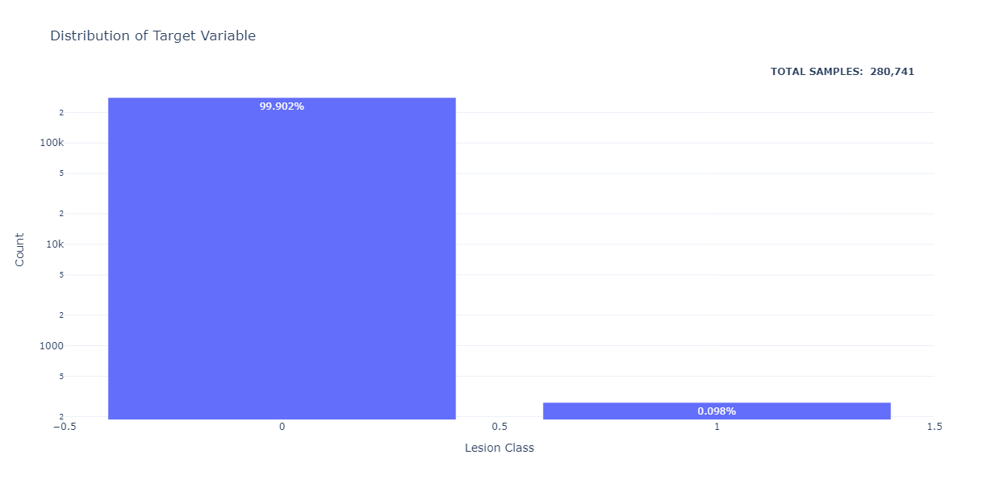

In [4]:
# Target Distribution

# Count the occurrences of each target value and sort by index
target_counts = train_df['target'].value_counts().sort_index()

# Calculate the total number of samples in the training DataFrame
total = len(train_df)

# Create a list of percentages for each target class, formatted as a string
percentage = [f'{count/total:0.3%}' for count in target_counts]

# Create a bar plot to visualize the distribution of the target variable
fig = go.Figure(data=[
    go.Bar(
        x=target_counts.index,  # X-axis represents the unique target classes
        y=target_counts.values,  # Y-axis represents the counts of each class
        text=percentage,  # Display percentages on top of the bars
        textposition='auto'  # Automatically position text on bars
    )
])

# Update layout of the plot with titles and formatting
fig.update_layout(
    title='Distribution of Target Variable',  # Main title of the plot
    xaxis_title='Lesion Class',  # Title for the X-axis
    yaxis_title='Count',  # Title for the Y-axis
    template='plotly_white',  # Use a white background for the plot
    height=600, width=1200  # Set the dimensions of the plot
)

# Set the y-axis to a logarithmic scale to better visualize class distributions
fig.update_layout(yaxis=dict(type='log'))

# Add an annotation to show the total number of samples in the dataset
fig.add_annotation(
    text=f"<b>TOTAL SAMPLES:  {total:,}</b>",  # Format total count with commas
    xref="paper", yref="paper",  # Reference the entire paper for positioning
    x=0.98, y=1.05,  # Position the annotation near the top-right corner
    showarrow=False,  # Do not show an arrow pointing to the text
    font=dict(size=12)  # Set the font size for the annotation
)

# Display the plot
fig.show()


## Visualize categorical features

In [5]:
import pandas as pd
import plotly.express as px

def plot_categorical_feature_distribution(
    df: pd.DataFrame,
    feature_col: str,
    target_col: str = 'target',
    target_as_str: bool = True,
    log_y: bool = False,
    template_theme: str = "plotly_white",
    group_by_target: bool = True,
    stack_bar: bool = False
) -> None:
    """
    Plots the distribution of a categorical feature, optionally grouped by a target variable.

    Args:
        df (pd.DataFrame): The DataFrame containing the data.
        feature_col (str): The name of the categorical feature column to plot.
        target_col (str, optional): The name of the target column. Defaults to 'target'.
        target_as_str (bool, optional): Whether to treat target variable as strings. Defaults to True.
        log_y (bool, optional): Whether to use a logarithmic scale for the Y-axis. Defaults to False.
        template_theme (str, optional): Plotly template theme to use. Defaults to 'plotly_white'.
        group_by_target (bool, optional): Whether to group bars by target variable. Defaults to True.
        stack_bar (bool, optional): Whether to stack bars instead of grouping. Defaults to False.

    Returns:
        None; displays the plot.
    """
    
    # Create a copy of the DataFrame and sort it based on feature and target columns
    _df = df.copy().sort_values(by=[feature_col, target_col]).reset_index(drop=True)

    # Check if we need to group the bars by the target variable
    if group_by_target:
        # Create a histogram plot grouped by the target variable
        fig = px.histogram(
            _df, x=feature_col, color=target_col,
            log_y=log_y, height=500, width=1200, template=template_theme,
            title=f'Distribution of {feature_col.upper()} By TARGET',
            barmode='group' if not stack_bar else 'stack'  # Choose between grouped or stacked bars
        )
    else:
        # Create a histogram plot without grouping by the target variable
        fig = px.histogram(
            _df, x=feature_col, color=feature_col, 
            log_y=log_y, height=500, width=1200, template=template_theme,
            title=f'<b>DISTRIBUTION OF {feature_col.replace("_", " ").upper()}',
        )  

    # Update the layout of the plot with titles and gaps
    fig.update_layout(
        bargap=0.1,  # Set the gap between bars
        xaxis_title=f"{feature_col.title()}",  # Format the X-axis title
        yaxis_title="Count",  # Title for the Y-axis
        showlegend=group_by_target  # Show legend only when grouped by target
    )

    # Apply log scale to the Y-axis if requested
    if log_y:
        fig.update_layout(yaxis_type="log")

    # Display the plot
    fig.show()


## AGE APPROX

In [6]:
plot_categorical_feature_distribution(train_df, "age_approx", group_by_target=False)

In [7]:
plot_categorical_feature_distribution(train_df, "age_approx", group_by_target=True, stack_bar=False, log_y=True)

## Anatom site general

In [8]:
plot_categorical_feature_distribution(train_df, "anatom_site_general", group_by_target=True, stack_bar=False, log_y = True)

## SEX

In [9]:
plot_categorical_feature_distribution(train_df, "sex", group_by_target=True, stack_bar=False, log_y=True)

# Visualize continuous features

In [10]:
def plot_continuous_feature_distribution(
    df: pd.DataFrame, 
    feature_col: str,
    plot_style: str = "histogram",
    feature_readable_name: str | None = None,
    target_col: str = "target",
    log_y: bool = False, 
    template_theme: str = "plotly_white",
    group_by_target: bool = True,
    n_bins: int = 50
) -> None:
    """
    Plots the distribution of a continuous feature in the DataFrame.

    Args:
        df (pd.DataFrame): The DataFrame containing the feature and target columns.
        feature_col (str): The name of the feature column to plot.
        plot_style (str, optional): The style of the plot ('histogram' or 'box'). Defaults to 'histogram'.
        feature_readable_name (str | None, optional): A readable name for the feature to use in the title. Defaults to None.
        target_col (str, optional): The name of the target column. Defaults to 'target'.
        log_y (bool, optional): Whether to apply a logarithmic scale to the y-axis. Defaults to False.
        template_theme (str, optional): The Plotly template theme to use for the plot. Defaults to 'plotly_white'.
        group_by_target (bool, optional): Whether to group the plot by the target variable. Defaults to True.
        n_bins (int, optional): The number of bins to use for the histogram. Defaults to 50.

    Raises:
        TypeError: If df is not a pandas DataFrame.
        ValueError: If feature_col or target_col are not found in the DataFrame or if plot_style is invalid.

    Returns:
        None: Displays the plot.
    """
    
    # Input validation
    if not isinstance(df, pd.DataFrame):
        raise TypeError("Input 'df' must be a pandas DataFrame.")
    if feature_col not in df.columns:
        raise ValueError(f"Feature column '{feature_col}' not found in DataFrame.")
    if target_col not in df.columns:
        raise ValueError(f"Target column '{target_col}' not found in DataFrame.")
    if plot_style not in ["histogram", "box"]:
        raise ValueError("Invalid plot_style. Choose either 'histogram' or 'box'.")
    
    # Make a copy of the DataFrame to avoid modifying the original data
    _df = df.copy().sort_values(by=[feature_col, target_col]).reset_index(drop=True)

    # Plotting logic based on the chosen plot style
    if plot_style == "histogram":
        if group_by_target:
            # Create a histogram for each target value
            fig = go.Figure()
            for target_value in _df[target_col].unique():
                subset = _df[_df[target_col] == target_value]
                fig.add_trace(go.Histogram(
                    x=subset[feature_col],
                    name=str(target_value),
                    opacity=0.7,
                    nbinsx=n_bins
                ))

            # Update layout for overlay histogram
            fig.update_layout(
                barmode='overlay',
                title=f"Distribution of {feature_readable_name or feature_col.upper()} by Target",
                height=500, width=1200, template=template_theme,
                xaxis_title=feature_readable_name or feature_col,
                yaxis_title="Count",
                showlegend=True
            )
        else:
            # Create a single histogram without grouping
            fig = px.histogram(
                _df, x=feature_col, log_y=log_y, height=500, width=1200, template=template_theme,
                title=f"Distribution of {feature_readable_name or feature_col.upper()}",
                nbins=n_bins
            )

            # Update layout for single histogram
            fig.update_layout(
                xaxis_title=feature_readable_name or feature_col,
                yaxis_title="Count",
                showlegend=False
            )

    elif plot_style == "box":
        if group_by_target:
            # Create a box plot for each target value
            fig = go.Figure()
            for target_value in _df[target_col].unique():
                subset = _df[_df[target_col] == target_value]
                fig.add_trace(go.Box(
                    y=subset[feature_col],
                    name=str(target_value),
                    boxpoints='outliers',  # Show outliers
                    boxmean=True  # Show mean in the box plot
                ))

            # Update layout for box plot grouped by target
            fig.update_layout(
                title=f'Distribution of {feature_readable_name or feature_col.upper()} by Target (includes likely outliers)', 
                height=500, width=1200, template=template_theme,
                xaxis_title='Target',
                yaxis_title=f'{feature_readable_name or feature_col}',
                showlegend=True
            )
        else:
            # Create a single box plot without grouping
            fig = px.box(
                _df, y=feature_col,
                height=500,
                width=1200,
                template=template_theme,
                title=f"Distribution of {feature_readable_name or feature_col.upper()}",
                points="outliers",  # Show outliers
            )
                             
            # Update layout for single box plot
            fig.update_layout(
                yaxis_title=f'{feature_readable_name or feature_col}',
                showlegend=False
            )   

    # Apply log scale to y-axis if requested (only for histogram)
    if log_y and plot_style == "histogram":
        fig.update_layout(yaxis_type='log')
    
    # Display the plot
    fig.show()



## clin_size_long_diam_mm

In [11]:
plot_continuous_feature_distribution(train_df, 'clin_size_long_diam_mm', plot_style="box", log_y=True, group_by_target=True)

In [12]:
plot_continuous_feature_distribution(train_df, 'clin_size_long_diam_mm', plot_style="histogram", log_y=True, group_by_target=True, n_bins=100)

## Create a pipeline to process the data 
* Handle missing valuee
* Encode categorical data
* Scale numeric data
* Transform 'age_approx' from float to int

In [13]:
# Custom transformer for handling missing values
class MissingValueHandler(BaseEstimator, TransformerMixin):
    # Fit method, not modifying any parameters, just returning self
    def fit(self, X, y=None):
        return self

    # Transform method to handle missing values
    def transform(self, X):
        # Ensure input is a pandas DataFrame
        if not isinstance(X, pd.DataFrame):
            raise TypeError("Input must be a pandas DataFrame.")

        # Identify numerical columns
        num_cols = X.select_dtypes(include=['int64', 'float64']).columns
        # Identify categorical columns
        cat_cols = X.select_dtypes(include=['object', 'category']).columns

        # Create imputer for numerical data using median
        num_imputer = SimpleImputer(strategy="median")
        # Apply imputer to numerical columns
        X[num_cols] = num_imputer.fit_transform(X[num_cols])

        # Create imputer for categorical data using the most frequent value
        cat_imputer = SimpleImputer(strategy="most_frequent")
        # Apply imputer to categorical columns
        X[cat_cols] = cat_imputer.fit_transform(X[cat_cols])

        return X  # Return the transformed DataFrame

# Custom transformer for one-hot encoding
class OneHotEncoderTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        # Initialize the OneHotEncoder with specified parameters
        self.encoder = OneHotEncoder(sparse_output=False, handle_unknown="ignore")

    # Fit method to learn the categories for encoding
    def fit(self, X, y=None):
        # Ensure input is a pandas DataFrame
        if not isinstance(X, pd.DataFrame):
            raise TypeError("Input must be a pandas DataFrame.")
        # Fit the encoder to categorical columns
        self.encoder.fit(X.select_dtypes(include=['object', 'category']))
        return self

    # Transform method to apply one-hot encoding
    def transform(self, X):
        # Ensure input is a pandas DataFrame
        if not isinstance(X, pd.DataFrame):
            raise TypeError("Input must be a pandas DataFrame.")

        # Transform categorical columns to one-hot encoding
        encoded_cols = self.encoder.transform(X.select_dtypes(include=['object', 'category']))
        # Get the new column names after encoding
        new_columns = self.encoder.get_feature_names_out(X.select_dtypes(include=['object', 'category']).columns)

        # Create a DataFrame for the encoded columns
        encode_df = pd.DataFrame(encoded_cols, columns=new_columns, index=X.index)
        # Concatenate the original DataFrame (excluding categorical columns) with the encoded DataFrame
        return pd.concat([X.select_dtypes(exclude=['object', 'category']), encode_df], axis=1)

# Custom transformer for scaling numerical features
class NumericalScaler(BaseEstimator, TransformerMixin):
    def __init__(self):
        # Initialize the StandardScaler for scaling numerical features
        self.scaler = StandardScaler()

    # Fit method to learn the scaling parameters
    def fit(self, X, y=None):
        # Ensure input is a pandas DataFrame
        if not isinstance(X, pd.DataFrame):
            raise TypeError("Input must be a pandas DataFrame.")
        # Identify numerical columns
        num_cols = X.select_dtypes(include=['int64', 'float64']).columns
        # Fit the scaler to the numerical columns
        self.scaler.fit(X[num_cols])
        return self

    # Transform method to apply scaling
    def transform(self, X):
        # Ensure input is a pandas DataFrame
        if not isinstance(X, pd.DataFrame):
            raise TypeError("Input must be a pandas DataFrame.")

        # Identify numerical columns
        num_cols = X.select_dtypes(include=['int64', 'float64']).columns
        # Apply scaling to the numerical columns
        X[num_cols] = self.scaler.transform(X[num_cols])
        return X  # Return the scaled DataFrame

# Custom transformer for handling age approximation
class AgeApproxTransformer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self  # No fitting required for this transformer

    # Transform method to round age approximations
    def transform(self, X):
        # Ensure input is a pandas DataFrame
        if not isinstance(X, pd.DataFrame):
            raise TypeError("Input must be a pandas DataFrame.")
        # Check if 'age_approx' is in the DataFrame
        if 'age_approx' in X.columns:
            # Round the age and convert to integer type
            X['age_approx'] = X['age_approx'].round().astype('Int64')
        return X  # Return the transformed DataFrame

# Create the complete pipeline for preprocessing
def create_pipeline() -> Pipeline:
    # Define a pipeline with the specified transformers
    pipeline = Pipeline(steps=[
        ('age_transformer', AgeApproxTransformer()),  # Age approximation
        ('missing_value_handler', MissingValueHandler()),  # Handling missing values
        ('num_scaler', NumericalScaler()),  # Scaling numerical features
        ('cat_encoder', OneHotEncoderTransformer())  # One-hot encoding categorical features
    ])
    return pipeline  # Return the constructed pipeline


## Use the pipeline to transform the train_df 

In [14]:
# Load the training metadata from a CSV file
train_df = pd.read_csv('../data/processed/train-metadata.csv')

# Drop the 'target' and 'isic_id' columns to create the feature set
X = train_df.drop(columns=['target', 'isic_id'])

# Keep the 'target' and 'isic_id' columns in a separate DataFrame for later use
temp = train_df[['target', 'isic_id']]

# Create the preprocessing pipeline using the previously defined function
pipeline = create_pipeline()

try:
    # Fit the pipeline to the feature set and transform the data
    processed_X = pipeline.fit_transform(X)
except Exception as e:
    # Log any errors that occur during fitting and transformation
    print(f"Error occurred during pipeline processing: {e}")

# Concatenate the processed features with the target and ISIC ID columns
processed_df = pd.concat([processed_X, temp], axis=1)

# Check for missing values
missing_values = processed_df.isnull().sum()

# Print the results of missing values
print("Missing values in each column:\n", missing_values)

Missing values in each column:
 age_approx                             0
clin_size_long_diam_mm                 0
sex_female                             0
sex_male                               0
anatom_site_general_anterior torso     0
anatom_site_general_head/neck          0
anatom_site_general_lower extremity    0
anatom_site_general_posterior torso    0
anatom_site_general_upper extremity    0
target                                 0
isic_id                                0
dtype: int64


## Correlation Analysis

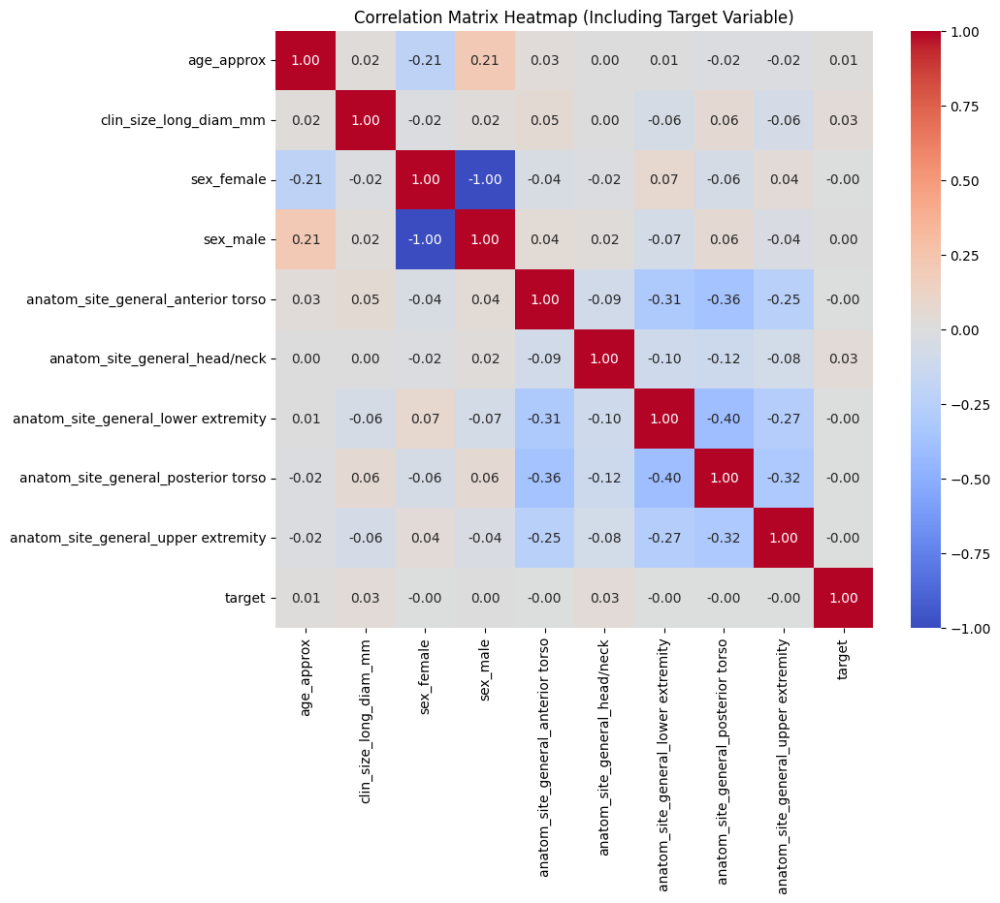

In [15]:
# Calculate the correlation matrix, excluding the 'isic_id' column
correlation_matrix = processed_df.drop(columns=['isic_id']).corr()

# Set the size of the plot
plt.figure(figsize=(10, 8))

# Create the heatmap using seaborn
sns.heatmap(
    correlation_matrix,            # The correlation matrix to visualize
    annot=True,                    # Annotate each cell with the numeric value
    fmt=".2f",                     # Format the annotation to two decimal places
    cmap='coolwarm',               # Color map for the heatmap
    square=True                    # Ensure each cell is square-shaped
)

# Set the title for the plot
plt.title('Correlation Matrix Heatmap (Including Target Variable)')

# Display the plot
plt.show()

## Plot image base on the general loaction of the lesion

In [16]:
#Load image from hdf5 file
def load_image_from_hdf5(isic_id: str,
                         file_path: str = "../data/raw/train-image.hdf5",
                         n_channels: int = 3):
    # Handle the case where the isic_id is passed incorrectly
    if not isic_id.lower().startswith("isic"):
        isic_id = f"ISIC_{int(str(isic_id).split('_', 1)[-1]):>07}"
        
    # Open the HDF5 file in read mode
    with h5py.File(file_path, 'r') as hf:
        
        # Retrieve the image data from the HDF5 dataset using the provided ISIC ID
        try:
            image_data = hf[isic_id][()]
        except KeyError:
            raise KeyError(f"ISIC ID {isic_id} not found in HDF5 file.")

        # Convert the binary data to a numpy array
        image_array = np.frombuffer(image_data, np.uint8)

        # Decode the image from the numpy array
        if n_channels == 3:
            # Load the image as a color image (BGR) and convert to RGB
            image = cv2.cvtColor(cv2.imdecode(image_array, cv2.IMREAD_COLOR), cv2.COLOR_BGR2RGB)
        else:
            # Load the image as a grayscale image
            image = cv2.imdecode(image_array, cv2.IMREAD_GRAYSCALE)

        # If the image failed to load for some reason (problems decoding) ...
        if image is None:
            raise ValueError(f"Could not decode image for ISIC ID: {isic_id}")
        
        return image

In [17]:
def plot_images_by_target(processed_df: pd.DataFrame, target_value: int, max_images: int = 10) -> None:
    """Load and plot images based on the target value.

    Args:
        processed_df (pd.DataFrame): The DataFrame containing image metadata.
        target_value (int): The target value to filter images.
        max_images (int, optional): Maximum number of images to display. Defaults to 10.
    
    Returns:
        None; displays a plot of the images.
    """
    # Validate inputs
    if not isinstance(target_value, int):
        raise ValueError("target_value must be an integer.")
    if not isinstance(max_images, int) or max_images <= 0:
        raise ValueError("max_images must be a positive integer.")

    # Filter the DataFrame for the specified target value and limit the number of images
    filtered_df = processed_df[processed_df['target'] == target_value].head(max_images)

    images = []  # Initialize a list to hold the loaded images
    for isic_id in filtered_df['isic_id']:
        try:
            # Load the image using the provided ISIC ID from the HDF5 file
            image = load_image_from_hdf5(isic_id)
            images.append(image)  # Append the loaded image to the list
        except Exception as e:
            print(f"Error loading image for ISIC ID {isic_id}: {e}")

    # Create a DataFrame to store the loaded images along with their metadata
    image_df = pd.DataFrame({
        'isic_id': filtered_df['isic_id'],
        'target': filtered_df['target'],
        'image': images
    })

    n_images = len(image_df)  # Get the number of images to display
    fig, axes = plt.subplots(1, n_images, figsize=(15, 5))  # Create a subplot for each image
    fig.suptitle(f'Images of Lesions with Target Value {target_value}', fontsize=14)  # Main title

    # Iterate over the axes, ISIC IDs, and images to display each image
    for ax, isic_id, img in zip(axes, image_df['isic_id'], image_df['image']):
        ax.imshow(img)  # Display the image
        ax.set_title(f'ISIC ID: {isic_id}', fontsize=5)  # Set the title for each image
        ax.axis('off')  # Hide the axis

    plt.tight_layout()  # Adjust layout to make room for the main title
    plt.show()  # Display the plot





    

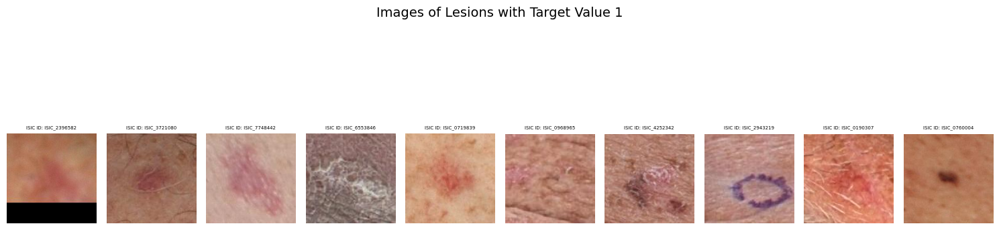

In [18]:
plot_images_by_target(processed_df, target_value=1, max_images=10)

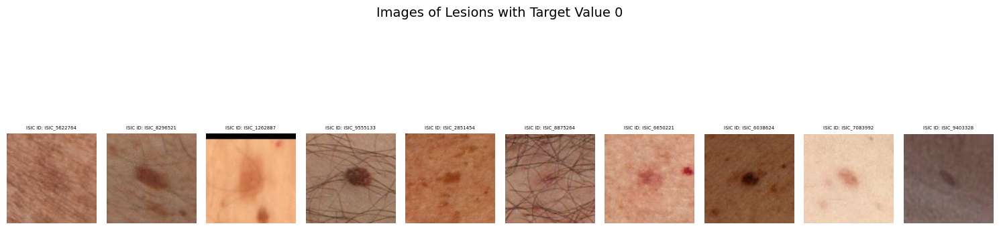

In [19]:
plot_images_by_target(processed_df, target_value=0, max_images=10)